# Import Necessary Libraries

In [1]:
import pandas as pd 
import numpy as np
import seaborn as sns
import pickle
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, LabelEncoder, MinMaxScaler
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
from sklearn.utils import resample
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
import shap
import torch
from Explainer import *

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
2024-09-30 16:11:49.448777: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


# Load Dataset

In [2]:
data = pd.read_csv("Alzheimer/Dataset/alzheimer_disease.csv")

# Explore Dataset

In [ ]:
data.head()

In [ ]:
data.info()

In [ ]:
data.describe()

# Data Preprocessing

In [ ]:
data.isnull().sum()

In [ ]:
data.duplicated().sum()

In [3]:
data = data[['PatientID', 'Age', 'Gender', 'Ethnicity', 'EducationLevel', 'BMI', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality', 'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'MemoryComplaints', 'BehavioralProblems', 'ADL', 'Diagnosis']]

In [ ]:
data.head()

In [ ]:
data.shape[1]

In [ ]:
gender_counts = data['Gender'].value_counts()
print("Gender distribution:\n", gender_counts)
sns.countplot(x='Gender', data=data)
plt.title('Gender Distribution')
plt.show()

In [ ]:
# Group the data by gender and outcome
grouped = data.groupby(['Gender', 'Diagnosis']).size().unstack(fill_value=0)

# Create a bar plot
grouped.plot(kind='bar', figsize=(8, 6))

# Set plot labels and title
plt.title('Outcome Distribution by Gender')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.xticks(rotation=0) # Rotate x-axis labels for readability
plt.legend(title='Diagnosis', labels=['Negative', 'Positive'])

# Split the data into Training and Testing

In [4]:
X = data.drop('Diagnosis', axis=1)
y = data['Diagnosis']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=40)

# Random Forest Classifier

In [5]:
naiveModel = RandomForestClassifier() #max_depth=15, max_features='sqrt', min_samples_leaf=2, min_samples_split=5, n_estimators=200
naiveModel.fit(X_train,y_train) 
y_pred = naiveModel.predict(X_test)

In [5]:
filename = 'random_forest_classifier.sav'

In [6]:
naiveModel = pickle.load(open('Alzheimer/Models/'+filename, 'rb'))
y_pred = naiveModel.predict(X_test)

# Gaussian Naive Bayes Model

In [ ]:
naiveModel = GaussianNB()
naiveModel.fit(X_train,y_train) 
y_pred = naiveModel.predict(X_test)

In [ ]:
filename = 'gaussian_naive_bayes.sav'

# Prediction Report

In [ ]:
print(classification_report(y_test, y_pred))
print(accuracy_score(y_test,y_pred))
confusion = confusion_matrix(y_test, y_pred)
print(confusion)
sns.heatmap(confusion, annot=True, fmt=".2f")

# Test Which Features are Influencing the Prediction

In [ ]:
shap_explainer = shap.Explainer(naiveModel)
shap_values = shap_explainer.shap_values(X_train)
shap.summary_plot(shap_values, X_train, feature_names=data.columns)

# Save the Model

In [ ]:
#Save the trained model
pickle.dump(naiveModel, open('Alzheimer2/Models/'+filename, 'wb'))

# Test Model Fairness

In [ ]:
#Model Fairness
from fairlearn.postprocessing import ThresholdOptimizer
from fairlearn.metrics import equalized_odds_difference, demographic_parity_difference

eo_diff = equalized_odds_difference(y_true=y_test, y_pred=y_pred, sensitive_features=X_test['Gender'])
dp_diff = demographic_parity_difference(y_true=y_test, y_pred=y_pred, sensitive_features=X_test['Gender'])

print(f"Demographic Parity Difference after post-processing: {dp_diff}")
print(f"Equalized Odds Difference after post-processing: {eo_diff}")

# Prepare the Affected Dataset

In [7]:
# Find instances where the model predicted target class 0
predicted_target_1_instances = X_test[y_pred == 1]
print(predicted_target_1_instances['Gender'].value_counts())

# males = predicted_target_0_instances[predicted_target_0_instances['sex'] == 0].sample(n=961, random_state=42)  # 42 is a random seed
# females = predicted_target_0_instances[predicted_target_0_instances['sex'] == 1].sample(n=961, random_state=42)
# filtered_test_data = pd.concat([males, females])
# predicted_target_0_instances = filtered_test_data.sample(frac=1, random_state=42)

# Save the filtered instances to a new dataset
predicted_target_1_instances.to_csv('Alzheimer/Dataset/predicted_target_1_instances.csv', index=False)

0    86
1    72
Name: Gender, dtype: int64


# RL Agent Training

X does not have valid feature names, but RandomForestClassifier was fitted with feature names


Action Sample: [8.153055 2.71823 ]
Max L1 Norm: 25.73
State: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Initial Label = [1]
Using cpu device
Wrapping the env in a DummyVecEnv.
$$$$$$$$$$$$$$$$$$$
RESET STATE: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
-----ENV RESET-----
$$$$$$$$$$$$$$$$$$$
Logging to ./counterfactuals_/SAC_1
Old State: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
----------------------------------------------------
Modifying old value of {MMSE} Feature - Index: 11 by amount = 0.5514887809753404
----------------------------------------------------
New State: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5515, 0.0, 0.0, 0.0]
----------------------------------------------------
counterfactuals listed [[0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.0], [0.0, 0.0, 0.5515], [0.0, 0.0, 0.0]]
Group 1 Proportion: 0.05
Group 2 Proportion: 0.01
Success Rate: 0.03
--------

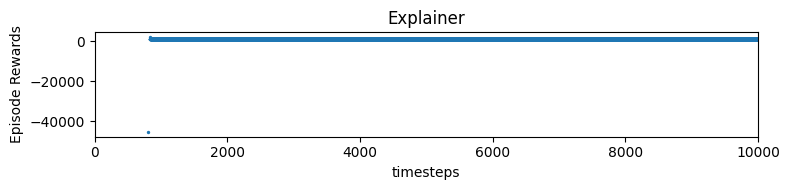

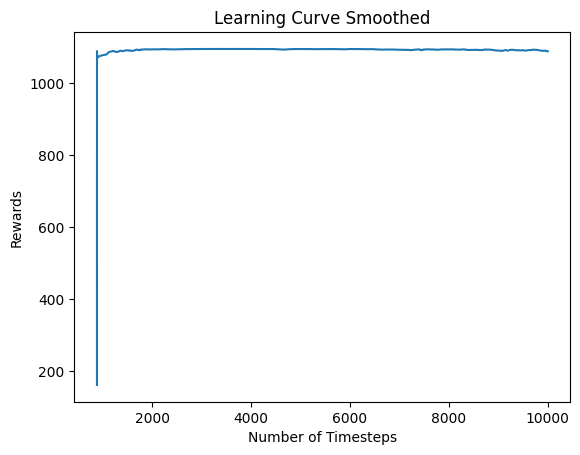

      FunctionalAssessment     ADL    MMSE     FunctionalAssessment     ADL  \
0                  -0.4134  3.3057  4.3209                   2.6336  2.1580   
1                  -0.3845  3.3718  4.7807                   2.4492  2.0789   
2                  -0.3883  3.6753  5.1153                   2.4247  2.0997   
3                  -0.3689  3.7856  4.6549                   2.5944  2.2257   
4                  -0.3578  4.0127  4.3291                   2.5944  2.0699   
...                    ...     ...     ... ..                   ...     ...   
9051               -0.0004  0.0004  0.0004                   0.0004  0.0004   
9052               -0.0004  0.0004  0.0004                   0.0004  0.0004   
9053               -0.0004  0.0004  0.0004                   0.0004  0.0004   
9054               -0.0004  0.0004  0.0004                   0.0004  0.0004   
9055               -0.0004  0.0004  0.0004                   0.0004  0.0004   

        MMSE     FunctionalAssessment     ADL  ... 

In [8]:
dataset = data
affected_dataset = predicted_target_1_instances
model = naiveModel  #naiveModel
target = 0
protected_attribute = "Gender"
features_to_change = ["FunctionalAssessment", "ADL", "MMSE"]
minimums = [0, 0, 0]
maximums = [10, 10, 30]
number_of_counterfactuals = 5

explainer = Explainer(dataset, affected_dataset, model, protected_attribute, features_to_change, number_of_counterfactuals, target, minimums, maximums, action_effectiveness=0.7)
explainer.train()

x, y = explainer.plot()
plt.show()
plt.plot(x, y)
plt.xlabel("Number of Timesteps")
plt.ylabel("Rewards")
plt.title("Learning Curve" + " Smoothed")
plt.show()

cfs = explainer.report_counterfactuals()
print(cfs)

In [9]:
cfs = explainer.report_counterfactuals()
cfs_sorted = cfs.sort_values(by='Reward', ascending=False)
cfs_sorted.to_csv('Alzheimer/Fair CF/fair_cf_new.csv', index=False)